In [8]:
import networkx as nx
import os
import glob
import pandas as pd
import numpy as np
from scipy import stats
import seaborn as sns
import pickle
import networkx as nx
import matplotlib as mlp
# mlp.use("Qt5Agg")
import matplotlib.pyplot as plt
import community
import scipy

# Functions

### Function to threshold graphs

In [91]:
def threshold(G, corr_direction, min_correlation):
    ##Creates a copy of the graph
    H = G.copy()
    ##Checks all the edges and removes some based on corr_direction
    for stock1, stock2, weight in list(G.edges(data=True)):
        ##if we only want to see the positive correlations we then delete the edges with weight smaller than 0
        if corr_direction == "positive":
            ####it adds a minimum value for correlation.
            ####If correlation weaker than the min, then it deletes the edge
            # print(weight["weight"])
            # pdb.set_trace()
            if weight["weight"] <0 or weight["weight"] < min_correlation:
                H.remove_edge(stock1, stock2)
        ##this part runs if the corr_direction is negative and removes edges with weights equal or largen than 0
        else:
            ####it adds a minimum value for correlation.
            ####If correlation weaker than the min, then it deletes the edge
            # print(weight["weight"])
            # pdb.set_trace()
            if weight["weight"] >=0 or weight["weight"] > min_correlation:
                H.remove_edge(stock1, stock2)
    return(H)

### Function to unpickle data

In [5]:
def onetoughjar(path2dic):
    with open(path2dic, 'rb') as pickle_file:
        try:
            while True:
                output = pickle.load(pickle_file)
        except EOFError:
            pass
    return(output)

### Function to create graphs of all the nodes

In [83]:
def grace_graph(graph, group,dirp,minp):
    graph=threshold(graph,dirp,minp)
    e,w = zip(*nx.get_edge_attributes(graph, 'weight').items())
    positions = nx.circular_layout(graph)
    size = 100
    title= "Modularity and edge weights \n of average %s graph"%(group)
    save="%s_graph.png"%(group)
    
    edges,weights = zip(*nx.get_edge_attributes(graph, 'weight').items())

    nodes, color = zip(*nx.get_node_attributes(graph, 'modules').items()) #if your modules are named different change here
    # nodes, names = zip(*nx.get_node_attributes(graph, 'label').items()) #if your modules are named different change here
    g=graph
    #Figure size
    plt.figure(figsize=(80,50))

    #draws nodes
    color = np.array(color)
    n_color=len(list(set(color)))
    # nColormap=plt.cm.Set3 #check here if you want different colors https://matplotlib.org/3.1.1/gallery/color/colormap_reference.html
    cM=color.max()
    cm=color.min()
    # get discrete colormap
    nColormap = plt.get_cmap('Set3', n_color)

    # scaling
    sz=np.array(size)
    scale=15000/sz.max()
    sza=sz*scale
    # print(sz.shape)

    y=nx.draw_networkx_nodes(g,positions,
                           node_color=color,
                           node_size=sza,
                           alpha=0.8,
                           cmap= nColormap,
                           vmin=cm ,vmax=cM)

    #Styling for labels
    nx.draw_networkx_labels(g, positions,
                            # labels = label_dict,
                            font_size=50,
                            font_family='sans-serif',
                            fontweight = 'bold')

    #draw edges
    weights=np.array(weights)
    eColormap=plt.cm.gist_rainbow #check here if you want different colors https://matplotlib.org/3.1.1/gallery/color/colormap_reference.html
    # scaling
    wt=list(set(weights))
    wt=np.array(wt)
    wt2=-np.sort(-wt)
    wt0=wt2[1]

    escale=1/wt0
    esza=weights*escale
    E=list(set(esza))
    E2=-np.sort(-np.array(E))
    M=1
    m=-1

    x=nx.draw_networkx_edges(g, positions,
                           edge_list=edges,
                           style='solid',
                           width = np.square(esza)*5,
                           edge_color = esza,
                           edge_cmap=eColormap,
                           edge_vmin=m,
                           edge_vmax=M)

    #COLORBAR STUFF
    node_bar=plt.colorbar(y, label='Module value')

    tick_locs = (np.arange(n_color) + 0.5)*(n_color-1)/n_color
    node_bar.set_ticks(tick_locs)

    # set tick labels (as before)
    node_bar.set_ticklabels(np.arange(n_color))


    sm = plt.cm.ScalarMappable(cmap=eColormap, norm=plt.Normalize(vmin = m, vmax=M))
    sm._A = []
    edge_bar=plt.colorbar(sm)

    for l in edge_bar.ax.yaxis.get_ticklabels():
        l.set_size(50)
    for l in node_bar.ax.yaxis.get_ticklabels():
        l.set_size(50)
        l.set_verticalalignment('center')

    node_bar.set_label('Modularity',fontsize = 50)
    edge_bar.set_label('Strength of edge weight',fontsize = 50)
    # Final plot stuff
    plt.axis('off')

    plt.title(title, fontsize = 100)
    basepath='/Users/gracer/Google Drive/HCP_graph/1200/images'

    plt.savefig(os.path.join(basepath,save), format="PNG")
    plt.show()
    return()

### Function to create communities

In [82]:
def ges(mu):
    partition = community.best_partition(mu)
    vals = list(partition.values())
    nx.set_node_attributes(mu, partition, 'modules')
    return((partition,vals, mu))

### Function to generate p values

In [14]:
from scipy.stats import pearsonr
import pandas as pd

def calculate_pvalues(df):
    df = df.dropna()._get_numeric_data()
    dfcols = pd.DataFrame(columns=df.columns)
    pvalues = dfcols.transpose().join(dfcols, how='outer')
    for r in df.columns:
        for c in df.columns:
            pvalues[r][c] = round(pearsonr(df[r], df[c])[1], 4)
    return pvalues

### Function to visualize the module graphs

In [165]:
def module_fig(G, Type):
    edges,weights = zip(*nx.get_edge_attributes(G,'weight').items())
    #nodes, size = zip(*nx.get_node_attributes(G,'clustering').items())

    positions=nx.circular_layout(G)
    plt.figure(figsize=(80,50))
    ### NODES ####
    color = np.array(list(G.nodes))
    color = np.array(color)
    n_color=len(list(set(color)))
    nColormap = plt.get_cmap('Set3', n_color)

    y=nx.draw_networkx_nodes(G,positions,
                           node_color=color,
                           node_size=15000,
                           alpha=1.0,
                           cmap= nColormap,
                           vmin=0,vmax=n_color )

    #Styling for labels
    nx.draw_networkx_labels(G, positions, font_size=100,
                            font_family='sans-serif', fontweight = 'bold')
    
    ### EDGES ####
    weights=np.array(weights)

    m=weights.min()
    M=weights.max()
    
    eColormap=plt.cm.gist_rainbow
    
    x=nx.draw_networkx_edges(G, positions, 
                             edge_list=edges,
                             style='solid', 
                             width = weights,
                             edge_color = weights, 
                             edge_vmin=m, 
                             edge_vmax=M, 
                             edge_cmap= eColormap)

    
    node_bar=plt.colorbar(y, label='Module value')
    
    tick_locs = (np.arange(n_color) + 0.5)*(n_color-1)/n_color
    node_bar.set_ticks(tick_locs)

    # set tick labels (as before)
    node_bar.set_ticklabels(np.arange(n_color))


    sm = plt.cm.ScalarMappable(cmap=eColormap, norm=plt.Normalize(vmin = m, vmax=M))
    sm._A = []
    edge_bar=plt.colorbar(sm)

    for l in edge_bar.ax.yaxis.get_ticklabels():
        l.set_size(50)
    for l in node_bar.ax.yaxis.get_ticklabels():
        l.set_size(50)
        l.set_verticalalignment('center')

    node_bar.set_label('Modularity',fontsize = 50)
    edge_bar.set_label('Strength of edge weight',fontsize = 50)
    
    plt.title("Module Connectivity Weights %s"%Type, fontsize = 100)
    plt.axis('off')
    basepath='/Users/gracer/Google Drive/HCP_graph/1200/images'
    plt.savefig(os.path.join(basepath,"modularity_%s.png"%(Type)), format="PNG")
    # plt.show()

### Function to look at the p values quickly

In [17]:
def skimP(mat):
    mask = np.zeros_like(mat)
    mask[np.triu_indices_from(mask)] = True
    with sns.axes_style("white"):
        f, ax = plt.subplots(figsize=(14, 10))
        ax = sns.heatmap(mat, mask=mask,annot=True, center=0.05,square=True, cmap='gist_ncar')
#         ax.set_title(name)

### Function to generate graph and metrics

In [182]:
def mu_make_graphs(key, values, direction, min_cor):
    ########################################
    cor_matrix = np.asmatrix(values)
    x=abs(cor_matrix)
    mu=x.mean()
    ########################################
    G = nx.from_numpy_matrix(cor_matrix)
    tG = threshold(G, direction, min_cor)
    if direction == 'negative':
        print('no partition')
        (partition,vals,graph)=('null','null','null')
    else:
    ########################################
        (partition,vals,graph)=ges(tG)
        nx.set_node_attributes(G, partition, 'modules')
    clustering = nx.clustering(tG, weight=True)
    # clustering_dict[key]=clustering
    ########################################
    centrality = nx.betweenness_centrality(tG, weight=True)
    # centrality_dict[key]=centrality
    ########################################
    nx.set_node_attributes(G, centrality, 'centrality')
    nx.set_node_attributes(G, clustering, 'clustering')
#     nx.set_node_attributes(G, pc_dict, 'PC')
    
    ########################################
    return({'mean_FC':mu, 'graphs':G, 'clustering_coeff':clustering, 'btn_centrality':centrality,  'modules':{'partition':partition,
    'values':vals,'graph':graph}})


## Base dictionary structure

In [7]:
base_dict={'BMI':{'IC1':{},'IC3':{},'IC4':{},'IC5':{},'IC6':{},'IC7':{},'IC8':{},'IC9':{},'IC10':{},'IC11':{},'IC12':{},'IC13':{},'IC14':{},'IC15':{}},
            'AoM':{'IC12':{},'IC15':{}},
            'int':{'IC2':{},'IC3':{},'IC6':{},'IC12':{},'IC13':{}}}

## Load in appropriate files

In [2]:
header=['IC1','IC2','IC3','IC4','IC5','IC6','IC7','IC8','IC9','IC10','IC11','IC12','IC13','IC14','IC15']

In [3]:
labels = pd.read_csv('/Users/gracer/Google Drive/HCP_graph/1200/brains/lables_glasser.csv', sep=',')

In [4]:
covars=pd.read_csv('/Users/gracer/Google Drive/HCP_graph/1200/datasets/subs510.csv', sep=',')

In [5]:
covars.drop_duplicates(subset='subject', keep="last", inplace=True)

In [6]:
covars['subject']=covars['subject'].astype('int64')

In [7]:
data_dict={}
for x in glob.glob('/Users/gracer/Downloads/HCP_S1200_PTNmaps_d15_25_50_100/3T_HCP1200_MSMAll_d15_ts2_Z/puberty/*.txt'):
    sub=x.split('/')[7].split('.')[0]
    data_dict[sub]=pd.read_csv(x,sep='\t',names=header)

237334
159441
157336
395756
401422
389357
151223
123925
706040
151425
257946
984472
788876
151627
147737
393247
140925
151829
153025
578057
748662
249947
180533
255639
175237
153227
835657
176845
613538
562345
397154
274542
567759
143426
869472
194140
748258
617748
771354
185139
905147
188347
468050
210415
309636
436845
368753
188145
210617
303119
412528
161731
295146
141422
101006
885975
212217
128127
665254
105923
196144
167036
882161
186545
827052
525541
111413
884064
566454
558960
663755
894673
154229
118023
901442
111211
171532
456346
285345
919966
126325
585862
143224
923755
130619
144832
825654
173536
140117
127832
153631
113215
765864
959574
154835
250427
177746
136732
117930
239136
167743
732243
103414
180735
280941
200614
715950
246133
911849
192641
193239
177140
930449
205220
169343
175742
138130
289555
103818
179346
873968
576255
227533
160830
161327
585256
196750
406836
599469
978578
541943
645551
192035
702133
841349
124422
161630
192237
395251
256540
128026
186444
168947

In [8]:
interest = {'BMI':{'IC1':{},'IC3':{},'IC4':{},'IC5':{},'IC6':{},'IC7':{},'IC8':{},'IC9':{},'IC10':{},'IC11':{},'IC12':{},'IC13':{},'IC14':{},'IC15':{}},
            'AoM':{'IC12':{},'IC15':{}},
            'int':{'IC2':{},'IC3':{},'IC6':{},'IC12':{},'IC13':{}}}

In [9]:
for x,y in interest.items():
    for k,v in y.items():
        for key, value in data_dict.items():
            v[key]=value[k]    

In [10]:
dfs = {'BMI':{'IC1':{},'IC3':{},'IC4':{},'IC5':{},'IC6':{},'IC7':{},'IC8':{},'IC9':{},'IC10':{},'IC11':{},'IC12':{},'IC13':{},'IC14':{},'IC15':{}},
            'AoM':{'IC12':{},'IC15':{}},
            'int':{'IC2':{},'IC3':{},'IC6':{},'IC12':{},'IC13':{}}}

## Create datatables with the rows as subjects and columns as parcels per IC

In [11]:
for key, value in interest.items():
    for k,v in value.items():
        x=pd.DataFrame.from_dict(v, orient='index')
        x['subject']=x.index
        x['subject'] = x['subject'].astype('int64')
        y=pd.merge(x, covars, left_on='subject', right_on='subject')
        del y['group']
        del y['index']
        y.set_index('subject', inplace=True)
        dfs[key][k]=y

In [12]:
corr_dict=base_dict

In [13]:
p_dict=base_dict

## Get correlations and p values

In [15]:
for key, value in dfs.items():
    print(key)
    for k,v in value.items():
        print(k)
        x=calculate_pvalues(v) 
        x=x.astype('float32')
        p_dict[key][k]=x

BMI
IC1
IC3
IC4
IC5
IC6
IC7
IC8
IC9
IC10
IC11
IC12
IC13
IC14
IC15
AoM
IC12
IC15
int
IC2
IC3
IC6
IC12
IC13


In [16]:
for key, value in dfs.items():
    print(key)
    for k,v in value.items():
        print(k)
        corr_dict[key][k]=v.corr(method='pearson')

BMI
IC1
IC3
IC4
IC5
IC6
IC7
IC8
IC9
IC10
IC11
IC12
IC13
IC14
IC15
AoM
IC12
IC15
int
IC2
IC3
IC6
IC12
IC13


In [23]:
p_dict['BMI']['IC1']['BMI_c'][p_dict['BMI']['IC1']['BMI_c'] < (0.05/300)]

19        0.0000
22        0.0001
31        0.0001
34        0.0001
37        0.0001
139       0.0000
202       0.0001
BMI_c     0.0000
motion    0.0000
Name: BMI_c, dtype: float32

In [42]:
for key, value in corr_dict['int'].items():
    print(key)
    print(value['int'][value['int']<-0.1])

IC2
AOM_c   -0.1265
Name: int, dtype: float64
IC3
90      -0.117493
100     -0.113787
103     -0.102200
181     -0.107460
188     -0.123952
190     -0.135351
281     -0.113965
285     -0.103377
287     -0.106151
AOM_c   -0.126500
Name: int, dtype: float64
IC6
108     -0.109782
AOM_c   -0.126500
Name: int, dtype: float64
IC12
AOM_c   -0.1265
Name: int, dtype: float64
IC13
48      -0.101617
AOM_c   -0.126500
Name: int, dtype: float64


In [3]:
ALL_DATA = onetoughjar('/Users/gracer/Google Drive/HCP_graph/1200/datasets/bak.pkl')

In [4]:
ALL_DATA.keys()

dict_keys(['corr', 'pvals', 'data'])

In [26]:
zscores=ALL_DATA['data']

In [28]:
zscores['BMI'].keys()

dict_keys(['IC1', 'IC3', 'IC4', 'IC5', 'IC6', 'IC7', 'IC8', 'IC9', 'IC10', 'IC11', 'IC12', 'IC13', 'IC14', 'IC15'])

## Thresholding the zscores 
Only keeping zscores > 3.5 and greater than 75 of the participants must have a value for the score to keep the column.

In [59]:
zscores_thr=base_dict

for key, value in zscores.items():
    print(key)
    for k,v in value.items():
        print(k)
        x = v[(v.iloc[:,1:379]>3.5) | (v.iloc[:,1:379]<-3.5)]
        y=x.dropna(axis=1, how='all')
        y = y.loc[:, y.isna().mean() < .75]
        z=pd.concat([v.iloc[:,379:], y], axis=1)
        zscores_thr[key][k]=z

BMI
IC1
IC3
IC4
IC5
IC6
IC7
IC8
IC9
IC10
IC11
IC12
IC13
IC14
IC15
AoM
IC12
IC15
int
IC2
IC3
IC6
IC12
IC13


In [83]:
zscores_thr['int']['IC12'].corr()['int'][zscores_thr['int']['IC12'].corr()['int']>0.1]

int    1.000000
39     0.128348
68     0.100524
170    0.109217
293    0.120476
Name: int, dtype: float64

## Generating the graphs with positive values

In [169]:
graphs=base_dict

for key, value in zscores_thr.items():
    for k, v in value.items():
        graphs[key][k]=mu_make_graphs(k, v.corr(), 'positive', 0)

## Generating graphs with negative values
Unable to get communities with negative values need to keep seperate

In [183]:
nega_graphs=base_dict

for key, value in zscores_thr.items():
    for k, v in value.items():
        nega_graphs[key][k]=mu_make_graphs(k, v.corr(), 'negative', 0)

no partition
no partition
no partition
no partition
no partition
no partition
no partition
no partition
no partition
no partition
no partition
no partition
no partition
no partition
no partition
no partition
no partition
no partition
no partition
no partition
no partition


## Renaming the graphs based off the correlation matrix

In [174]:
for key, value in zscores_thr.items():
    for k, v in value.items():
        cor=v.corr()
        stocks = cor.index.values
#         print(stocks)
        graphs[key][k]['graphs'] = nx.relabel_nodes(graphs[key][k]['graphs'],lambda x: stocks[x])

['BMI_c' 'AOM_c' 'int' 'race' 'age' 'motion' 20 21 22 23 24 25 29 31 34 37
 38 39 40 41 44 64 68 74 80 87 96 98 99 113 114 129 134 135 155 162 163
 164 165 169 170 171 174 175 176 177 197 200 201 202 203 204 205 209 211
 214 217 218 219 220 221 244 248 254 260 267 276 278 294 309 314 315 339
 345 350 351 354 356 357 377]
['BMI_c' 'AOM_c' 'int' 'race' 'age' 'motion' 19 20 21 22 23 24 31 38 39 40
 170 174 176 177 199 200 201 202 203 204 211 218 219 220 350 354 356 357]
['BMI_c' 'AOM_c' 'int' 'race' 'age' 'motion' 20 21 23 24 25 28 29 31 34 35
 36 37 38 39 40 41 64 66 67 68 74 96 98 113 114 134 135 154 155 156 158
 159 160 161 164 165 170 172 174 175 176 177 178 181 200 203 204 205 208
 209 211 214 215 216 217 218 219 220 221 244 245 246 247 248 293 314 315
 336 339 341 344 350 352 354 355 356 357 358 361]
['BMI_c' 'AOM_c' 'int' 'race' 'age' 'motion' 29 43 44 47 51 52 53 64 68 79
 80 81 82 84 87 88 89 90 91 95 97 98 99 100 101 103 104 105 107 113 115
 116 135 150 151 155 162 163 164 168 1

In [188]:
for key, value in zscores_thr.items():
    for k, v in value.items():
        cor=v.corr()
        stocks = cor.index.values
#         print(stocks)
        nega_graphs[key][k]['graphs'] = nx.relabel_nodes(nega_graphs[key][k]['graphs'],lambda x: stocks[x])

['BMI_c' 'AOM_c' 'int' 'race' 'age' 'motion' 20 21 22 23 24 25 29 31 34 37
 38 39 40 41 44 64 68 74 80 87 96 98 99 113 114 129 134 135 155 162 163
 164 165 169 170 171 174 175 176 177 197 200 201 202 203 204 205 209 211
 214 217 218 219 220 221 244 248 254 260 267 276 278 294 309 314 315 339
 345 350 351 354 356 357 377]
['BMI_c' 'AOM_c' 'int' 'race' 'age' 'motion' 19 20 21 22 23 24 31 38 39 40
 170 174 176 177 199 200 201 202 203 204 211 218 219 220 350 354 356 357]
['BMI_c' 'AOM_c' 'int' 'race' 'age' 'motion' 20 21 23 24 25 28 29 31 34 35
 36 37 38 39 40 41 64 66 67 68 74 96 98 113 114 134 135 154 155 156 158
 159 160 161 164 165 170 172 174 175 176 177 178 181 200 203 204 205 208
 209 211 214 215 216 217 218 219 220 221 244 245 246 247 248 293 314 315
 336 339 341 344 350 352 354 355 356 357 358 361]
['BMI_c' 'AOM_c' 'int' 'race' 'age' 'motion' 29 43 44 47 51 52 53 64 68 79
 80 81 82 84 87 88 89 90 91 95 97 98 99 100 101 103 104 105 107 113 115
 116 135 150 151 155 162 163 164 168 1

## Visualizing the total graphs for all ICs in the interaction group

/Users/gracer/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


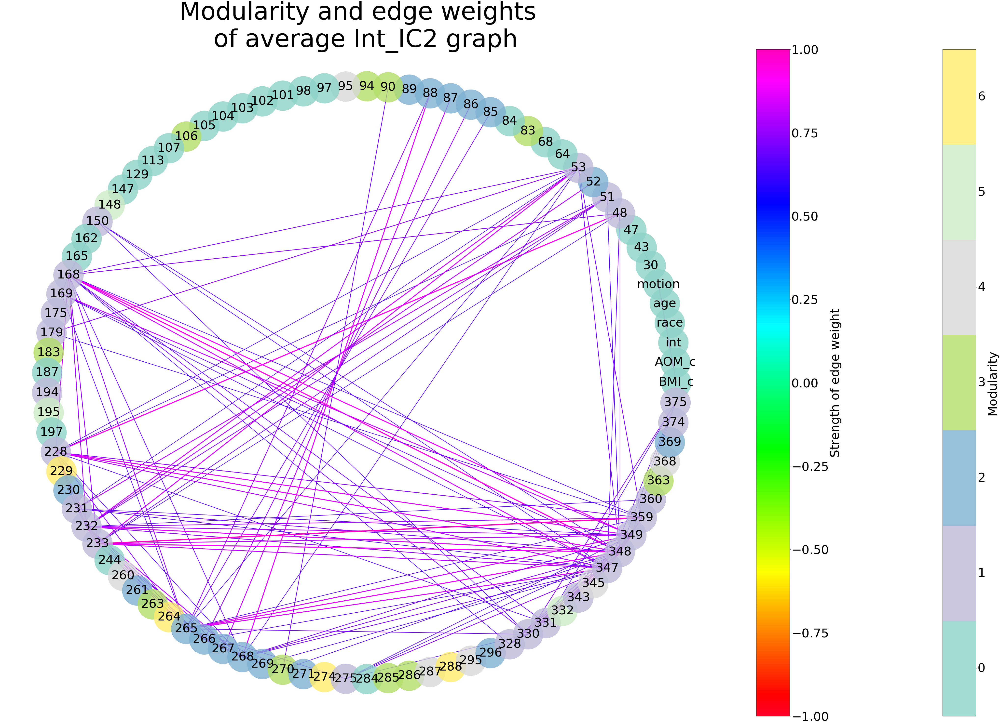

/Users/gracer/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


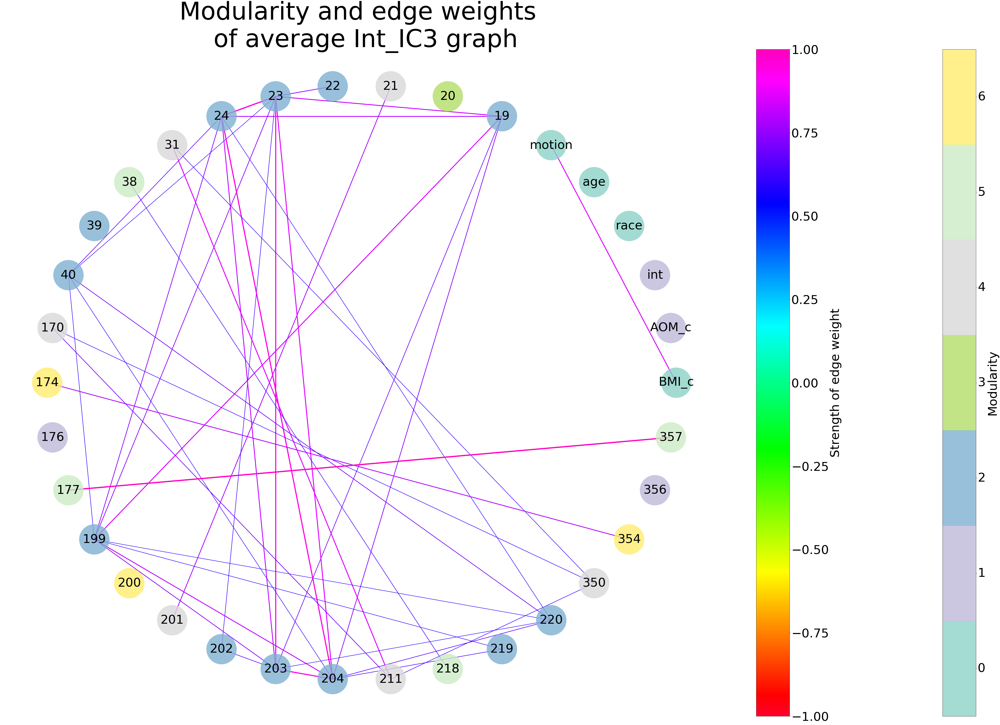

/Users/gracer/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


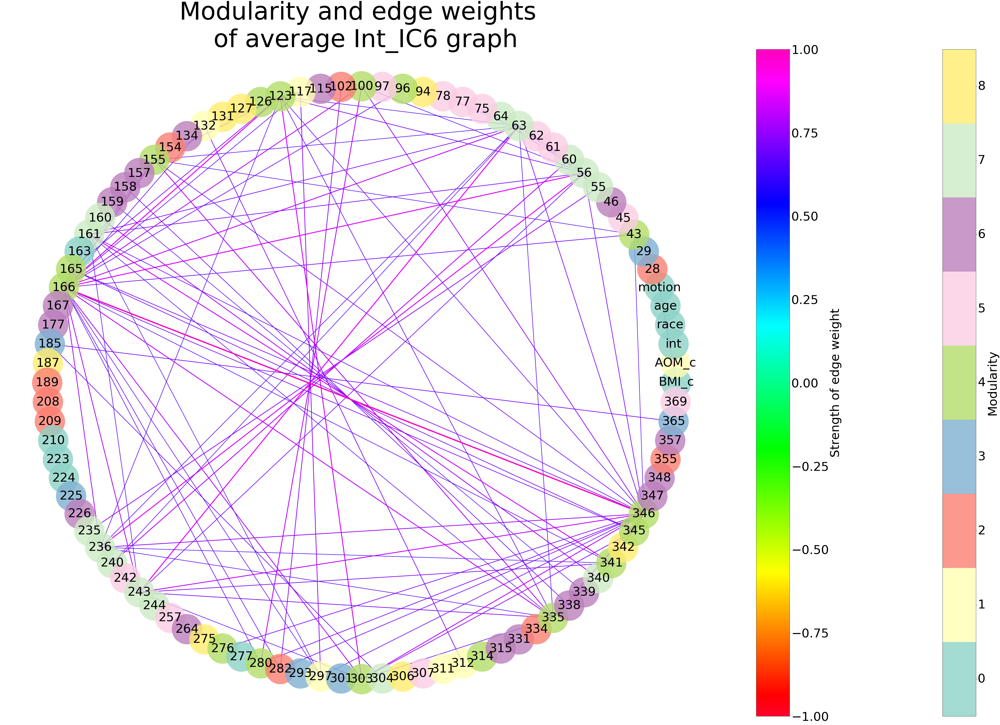

/Users/gracer/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


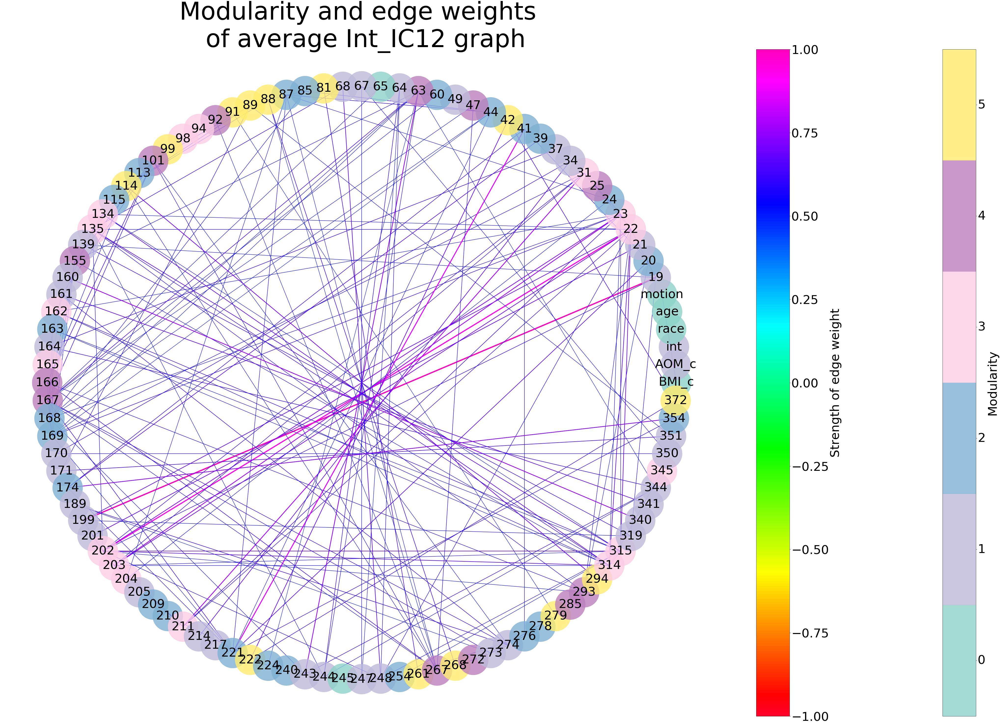

/Users/gracer/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


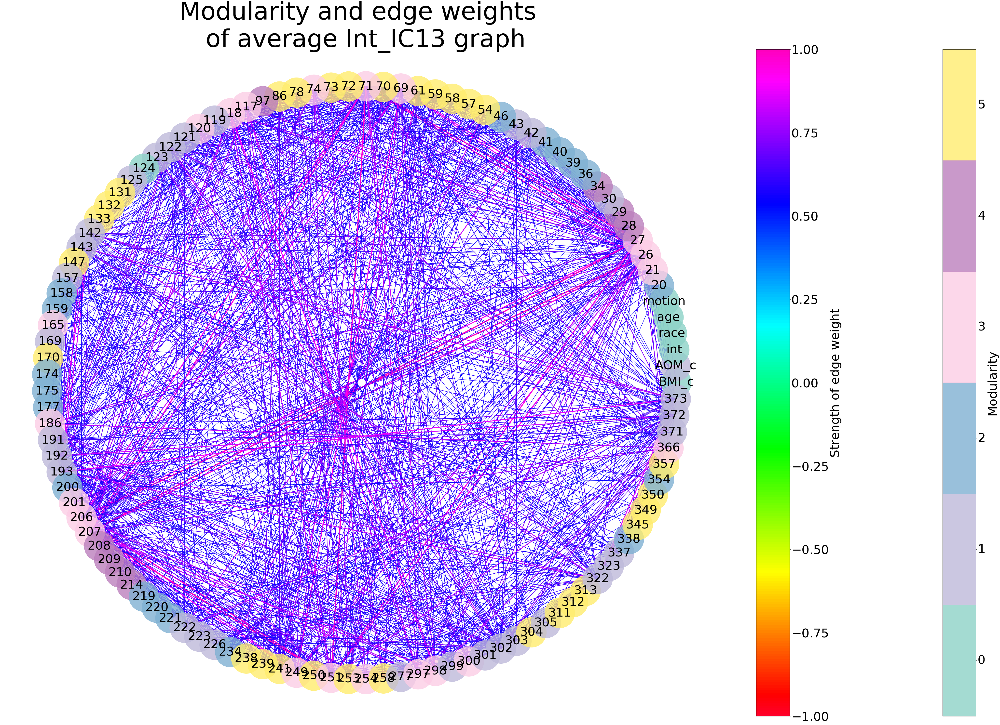

In [175]:
for key, value in graphs['int'].items():
    grace_graph(value['graphs'], 'Int_%s'%key, 'positive',0.5)

## writing all the adjacency matrices and topologocial values to csv to save

In [266]:
for key, value in graphs.items():
    print(key)
    for k, v in value.items():
        print(k)
        cc=pd.DataFrame.from_dict(v['clustering_coeff'], orient='index')
        btw=pd.DataFrame.from_dict(v['btn_centrality'], orient='index')
        mod=pd.DataFrame.from_dict(v['modules']['partition'], orient='index')
        test3 = pd.concat([cc, btw, mod], axis=1)
        test3.columns = ['cc','btw','mod']
        print(test3.shape)
        test3.set_index([list(zscores_thr[key][k].columns.values)], inplace=True)
        adj=nx.to_pandas_adjacency(v['graphs'])
        print(adj.shape)
        df=adj.merge(test3, left_index=True, right_index=True)
        pd.DataFrame.to_csv(df, '/Users/gracer/Google Drive/HCP_graph/1200/datasets/%s_%s_thresh.csv'%(key,k))

BMI
IC1
(80, 3)
(80, 80)
IC3
(34, 3)
(34, 34)
IC4
(85, 3)
(85, 85)
IC5
(98, 3)
(98, 98)
IC6
(96, 3)
(96, 96)
IC7
(72, 3)
(72, 72)
IC8
(19, 3)
(19, 19)
IC9
(86, 3)
(86, 86)
IC10
(73, 3)
(73, 73)
IC11
(74, 3)
(74, 74)
IC12
(104, 3)
(104, 104)
IC13
(113, 3)
(113, 113)
IC14
(66, 3)
(66, 66)
IC15
(85, 3)
(85, 85)
AoM
IC12
(104, 3)
(104, 104)
IC15
(85, 3)
(85, 85)
int
IC2
(93, 3)
(93, 93)
IC3
(34, 3)
(34, 34)
IC6
(96, 3)
(96, 96)
IC12
(104, 3)
(104, 104)
IC13
(113, 3)
(113, 113)


In [267]:
for key, value in nega_graphs.items():
    print(key)
    for k, v in value.items():
        print(k)
        cc=pd.DataFrame.from_dict(v['clustering_coeff'], orient='index')
        btw=pd.DataFrame.from_dict(v['btn_centrality'], orient='index')
        test3 = pd.concat([cc, btw], axis=1)
        test3.columns = ['cc','btw']
        test3.set_index([list(zscores_thr[key][k].columns.values)], inplace=True)
        test3.set_index([list(zscores_thr[key][k].columns.values)], inplace=True)
        pd.DataFrame.to_csv(test3, '/Users/gracer/Google Drive/HCP_graph/1200/datasets/%s_%s_thresh_neg.csv'%(key,k))

BMI
IC1
IC3
IC4
IC5
IC6
IC7
IC8
IC9
IC10
IC11
IC12
IC13
IC14
IC15
AoM
IC12
IC15
int
IC2
IC3
IC6
IC12
IC13


### Pickling the dictionaries to save them

In [177]:
ALL_DICT = {'graphs':graphs, 'zthresh':zscores_thr, 'nega_graphs':nega_graphs}

NameError: name 'graphs' is not defined

In [190]:
pickle.dump(ALL_DICT, open('/Users/gracer/Google Drive/HCP_graph/1200/datasets/bak2.pkl', 'wb'), protocol=4)

In [9]:
ALL_DATA = onetoughjar('/Users/gracer/Google Drive/HCP_graph/1200/datasets/bak2.pkl')

NameError: name 'onetoughjar' is not defined

In [179]:
ALL_DATA.keys()

dict_keys(['graphs', 'zthresh', 'nega_graphs'])

In [214]:
ALL_DATA['zthresh']['int']['IC13'].corr()['int'].sort_values()

AOM_c   -0.126500
350     -0.113211
97      -0.111643
221     -0.107761
303     -0.082928
43      -0.073270
277     -0.073092
177     -0.067801
21      -0.062911
147     -0.061427
214     -0.061046
20      -0.056983
174     -0.055666
371     -0.053248
201     -0.049640
40      -0.047863
223     -0.046933
170     -0.045869
122     -0.045699
39      -0.044637
59      -0.044063
210     -0.041807
372     -0.040703
118     -0.040699
337     -0.038197
123     -0.035427
119     -0.032254
157     -0.031924
312     -0.031553
238     -0.031310
           ...   
249      0.019095
BMI_c    0.019167
241      0.019668
222      0.020273
220      0.020412
70       0.020538
206      0.020588
323      0.021227
132      0.023363
299      0.023723
143      0.029725
322      0.030459
72       0.031986
304      0.033259
26       0.035939
54       0.040340
373      0.042244
133      0.045584
86       0.046103
121      0.046746
age      0.047752
301      0.050253
226      0.056133
175      0.069273
124      0

In [230]:
labels.iloc[365]

L_Amygdala    L_Ig_ROI
Name: 365, dtype: object

In [24]:
G=ALL_DATA['graphs']['int']['IC13']['graphs']

IC2
0
['BMI_c', 'AOM_c', 'int', 'race', 'age', 'motion', 30, 43, 47, 64, 68, 84, 97, 98, 101, 102, 103, 104, 105, 107, 113, 129, 147, 162, 165, 187, 197, 244, 284]


/Users/gracer/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


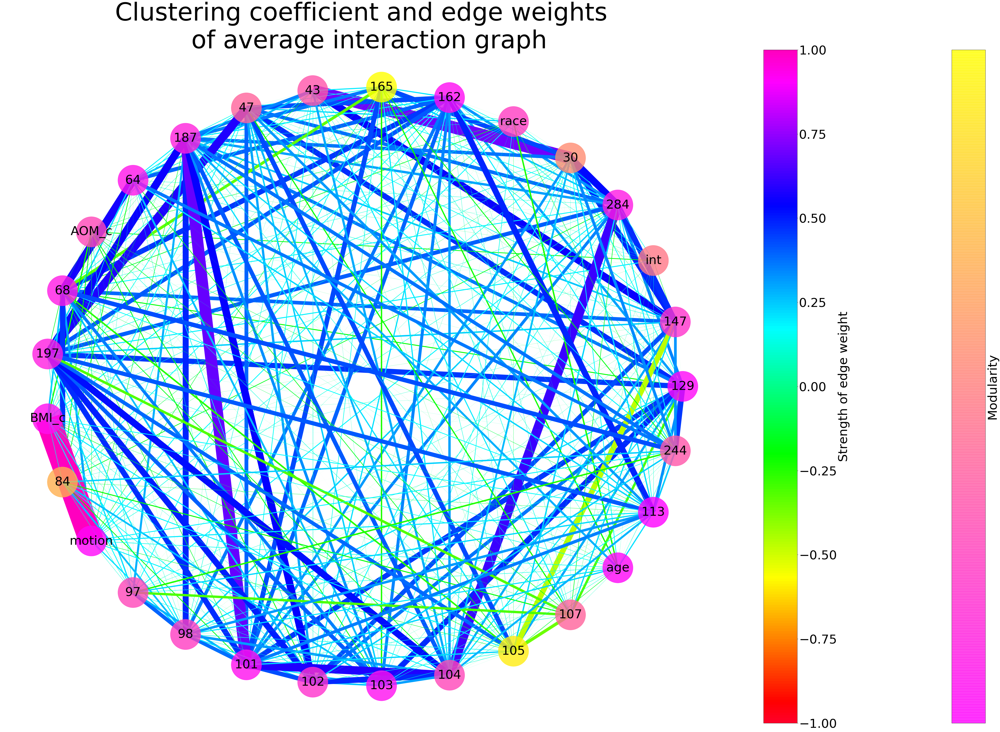

IC3
1
['AOM_c', 'int', 176, 356]


/Users/gracer/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


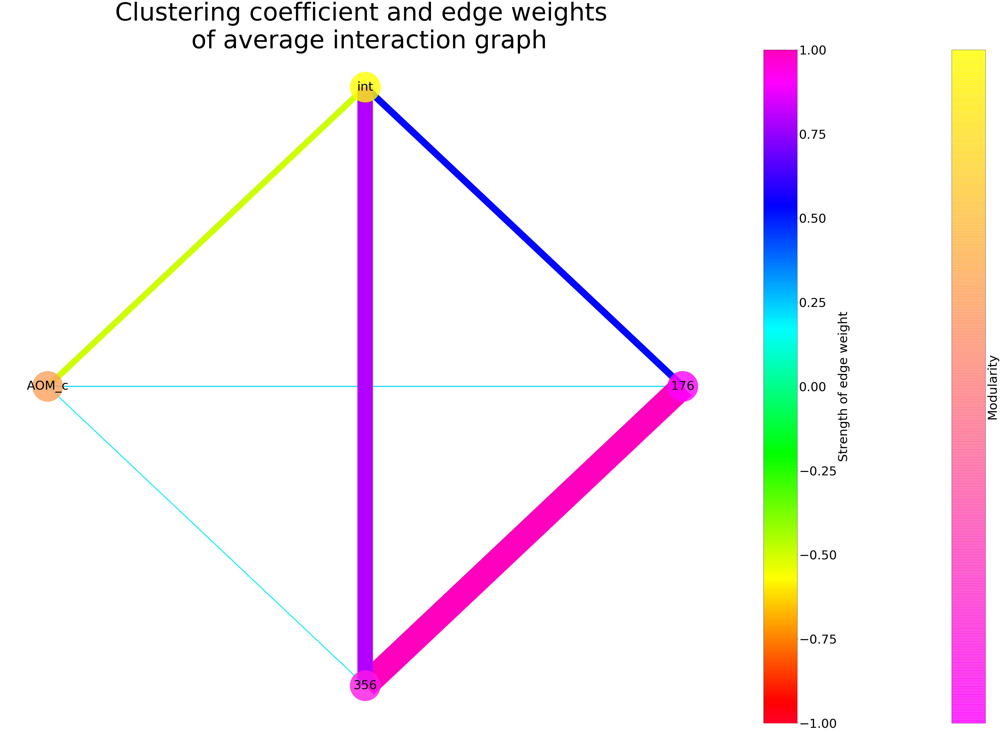

IC6
0
['BMI_c', 'int', 'race', 'age', 'motion', 163, 210, 223, 224, 277]


/Users/gracer/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


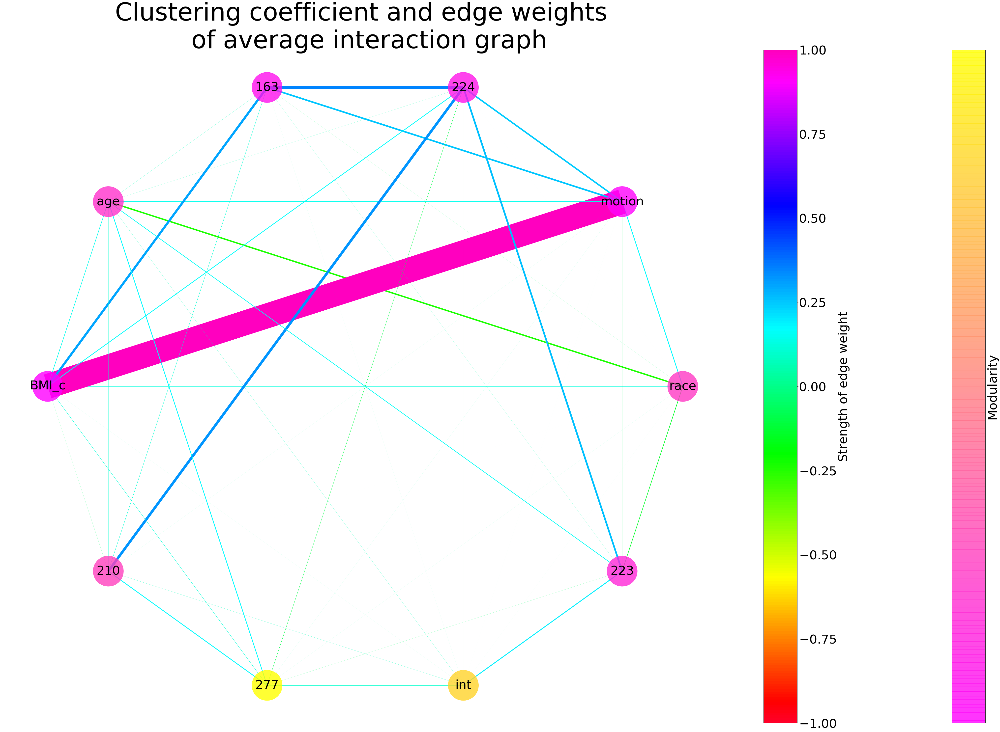

IC12
1
['AOM_c', 'int', 19, 21, 34, 37, 49, 64, 67, 68, 139, 160, 161, 164, 170, 171, 189, 199, 201, 205, 214, 217, 243, 244, 247, 248, 273, 274, 319, 340, 341, 344, 350, 351]


/Users/gracer/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


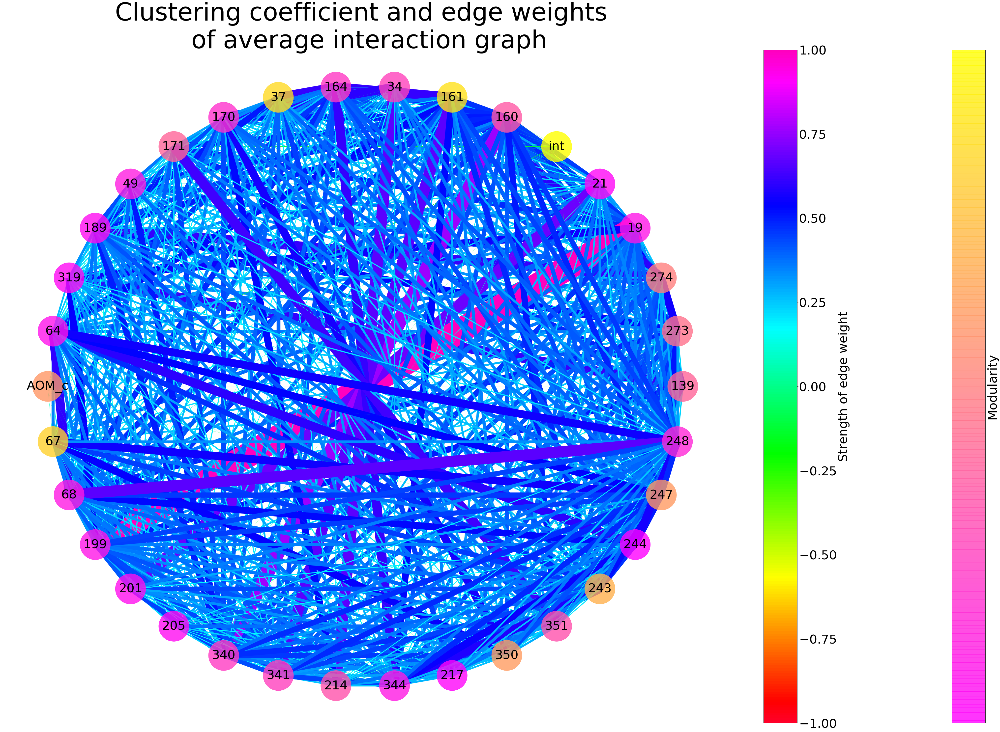

IC13
0
['BMI_c', 'int', 'race', 'age', 'motion', 124]


/Users/gracer/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


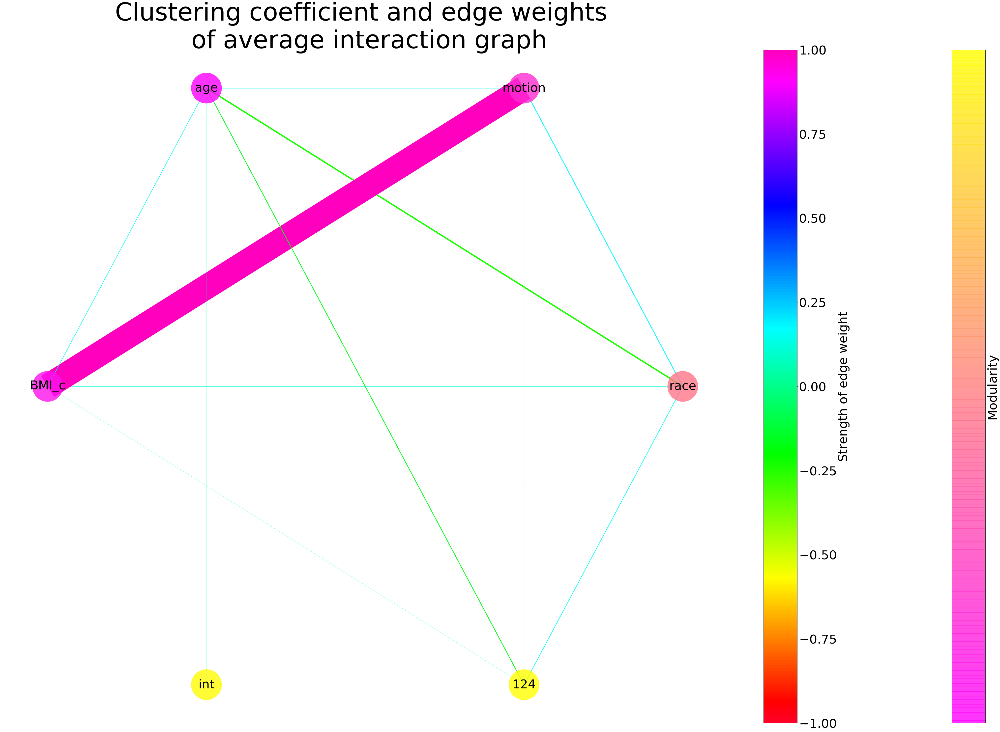

In [229]:
subgraphs={'BMI':{'IC1':{},'IC3':{},'IC4':{},'IC5':{},'IC6':{},'IC7':{},'IC8':{},'IC9':{},'IC10':{},'IC11':{},'IC12':{},'IC13':{},'IC14':{},'IC15':{}},
            'AoM':{'IC12':{},'IC15':{}},
            'int':{'IC2':{},'IC3':{},'IC6':{},'IC12':{},'IC13':{}}}

for IC, value in ALL_DATA['graphs']['int'].items():
    print(IC)
    G=value['graphs']
    mod=G.nodes(data=True)['int']['modules']
    print(mod)
    interest=[k for k,v in nx.get_node_attributes(G, 'modules').items() if v == mod]
    print(interest)
    X=nx.subgraph(G, interest)
    subgraphs['int'][IC]=X
    grace_graph(X, 'interaction')

/Users/gracer/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


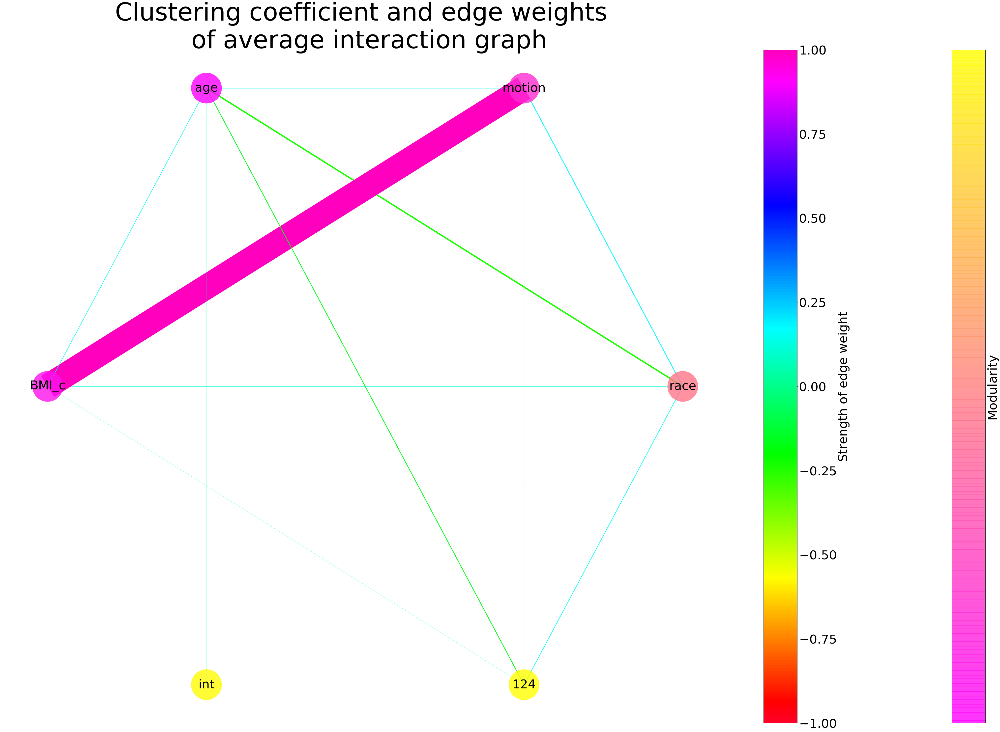

()

In [94]:
grace_graph(X, 'interaction')

## Creating module based graphs

In [ ]:
ALL_DATA['graphs']['int']['IC13']['graphs']
for key, value in summary_dict.items():
    for k,v in value.items():
        # community.induced_graph(partition dictionary, graph)
         comm_graph = community.induced_graph(v['modules']['partition'], v['graphs'])
         v.update(comm_graph = comm_graph)

In [149]:
comm_graph = community.induced_graph(ALL_DATA['graphs']['int']['IC13']['modules']['partition'], 
                                    ALL_DATA['graphs']['int']['IC13']['modules']['graph'])

/Users/gracer/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


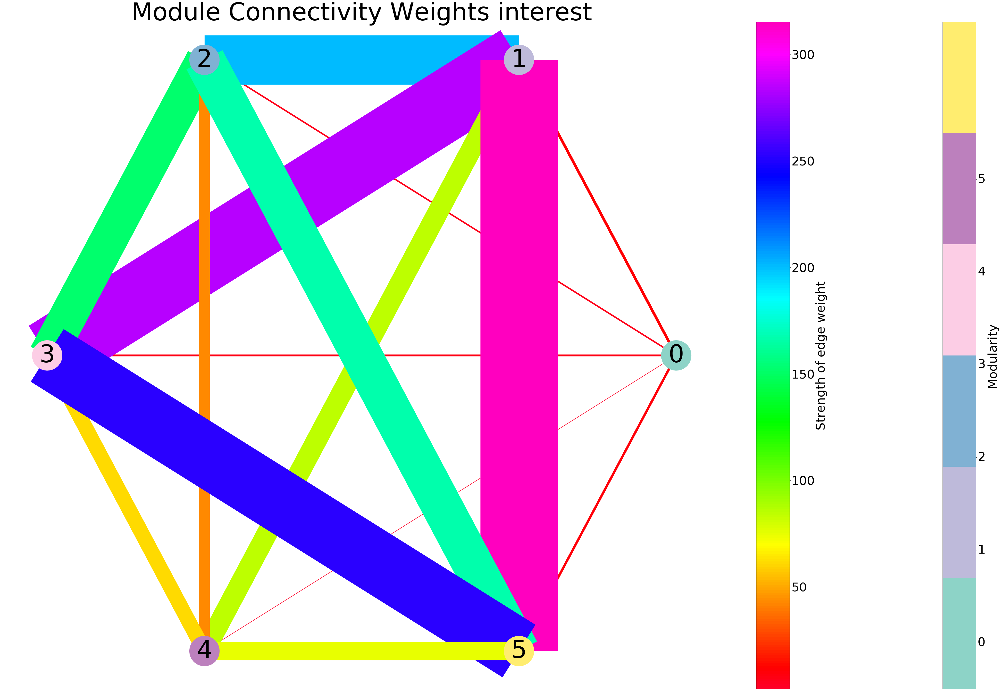

In [166]:
module_fig(comm_graph, 'interest')